<a href="https://colab.research.google.com/github/Vainres/VietnameseSign/blob/main/VietnameseSign.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install roboflow

     |████████████████████████████████| 145 kB 5.1 MB/s 
     |████████████████████████████████| 178 kB 28.5 MB/s 
     |████████████████████████████████| 1.1 MB 34.6 MB/s 
     |████████████████████████████████| 67 kB 5.3 MB/s 
     |████████████████████████████████| 54 kB 2.6 MB/s 
     |████████████████████████████████| 138 kB 34.8 MB/s 
     |████████████████████████████████| 596 kB 30.3 MB/s 
     |████████████████████████████████| 63 kB 1.5 MB/s 
  Created wheel for roboflow: filename=roboflow-0.2.4-py3-none-any.whl size=21356 sha256=e81a371f998b311aed4ded1c448f0bd8849551c26da07291887118dfe938ed94
  Stored in directory: /root/.cache/pip/wheels/b7/2c/60/3733c0e323b1d7aec00f852264314bf6c48192c8e1dc92b3ee
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9675 sha256=d444d4d97841ee51b74b09865f6ee7b38588471d0c05f1cd3d6854ffd797e5d9
  Stored in directory: /root/.cache/pip/wheels/a1/b6/7c/0e63e34eb06634181c63adacca38b79ff8f35c37e3c13e3c02
Successfully built roboflow wget

In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="DDsmUAHTgEPe4dK7niG2")
project = rf.workspace("vietnamesesign").project("vietnamesesign")
dataset = project.version(1).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to VietnameseSign-1 in yolov5pytorch:: 100%|██████████| 4012/4012 [00:04<00:00, 840.58it/s] 


In [ ]:
!git clone https://github.com/Vainres/VietnameseSign.git

Cloning into 'VietnameseSign'...
remote: Enumerating objects: 12, done.
remote: Counting objects: 100% (12/12), done.
remote: Compressing objects: 100% (10/10), done.
remote: Total 12 (delta 0), reused 12 (delta 0), pack-reused 0
Unpacking objects: 100% (12/12), done.


In [ ]:
!cat /content/VietnameseSign-1/data.yaml

names:
- text
nc: 1
train: VietnameseSign-1/train/images
val: VietnameseSign-1/valid/images


In [ ]:
!git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 13468, done.
remote: Counting objects: 100% (54/54), done.
remote: Compressing objects: 100% (49/49), done.
remote: Total 13468 (delta 27), reused 15 (delta 5), pack-reused 13414
Receiving objects: 100% (13468/13468), 12.11 MiB | 23.31 MiB/s, done.
Resolving deltas: 100% (9382/9382), done.


In [ ]:
!pip install -qr yolov5/requirements.txt

In [ ]:
import torch
import torchvision as tv
# kiểm tra notebook đã dùng GPU (thời gian huấn luyện nhanh hơn)
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 1.11.0+cu113 _CudaDeviceProperties(name='Tesla K80', major=3, minor=7, total_memory=11441MB, multi_processor_count=13)


In [ ]:
%%time
!python yolov5/train.py --img 416 --batch 16 --epochs 100 \
  --data /content/VietnameseSign-1/data.yaml \
  --cfg /content/VietnameseSign-1/vietnameseSigncfg.yaml \
  --weights '' --name custom_model  --cache

train: weights=, cfg=/content/VietnameseSign-1/vietnameseSigncfg.yaml, data=/content/VietnameseSign-1/data.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=yolov5/runs/train, name=custom_model, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-177-gd059d1d torch 1.11.0+cu113 CUDA:0 (Tesla K80, 11441MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2,

In [ ]:
!gdown --id 1Q_G6Lmf_7bT6q7c8mK8ZeDvn4aRY5jrD

/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1Q_G6Lmf_7bT6q7c8mK8ZeDvn4aRY5jrD
To: /content/best.pt
100% 14.8M/14.8M [00:00<00:00, 101MB/s] 


In [ ]:
!python yolov5/detect.py --weights /content/best.pt \
    --img 416 --conf 0.4 \
    --source /content/VietnameseSign-1/test/images \
    --save-txt

detect: weights=['/content/best.pt'], source=/content/VietnameseSign-1/test/images, data=yolov5/data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-200-g1b8e70f Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
vietnameseSigncfg summary: 232 layers, 7246518 parameters, 0 gradients, 16.8 GFLOPs
image 1/200 /content/VietnameseSign-1/test/images/im0041_jpg.rf.b957186882710373cc6ea57823fbd34d.jpg: 416x416 7 texts, Done. (0.025s)
image 2/200 /content/VietnameseSign-1/test/images/im0056_jpg.rf.6e738cb1460fc541ecbae5efb5a066ea.jpg: 416x416 25 texts, Done. (0.025s)
image 3/200 /content/VietnameseSign-1/test/images/im0072_jpg.r

In [ ]:
from typing import Tuple
import numpy as np
from PIL import Image, ImageDraw, ImageFont
import cv2
def cv2_img_add_text(img, text, left_corner: Tuple[int, int],
                     text_rgb_color=(255, 0, 0), text_size=24, font='arial.ttc', **option):
    pil_img = img
    if isinstance(pil_img, np.ndarray):
        pil_img = Image.fromarray(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    draw = ImageDraw.Draw(pil_img)
    font_text = ImageFont.truetype(font=font, size=text_size, encoding=option.get('encoding', 'utf-8'))
    draw.text(left_corner, text, text_rgb_color, font=font_text)
    cv2_img = cv2.cvtColor(np.asarray(pil_img), cv2.COLOR_RGB2BGR)
    if option.get('replace'):
        img[:] = cv2_img[:]
        return None
    return cv2_img

In [ ]:
! pip install --quiet vietocr

     |████████████████████████████████| 280 kB 8.7 MB/s 
     |████████████████████████████████| 948 kB 40.0 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.4.0 which is incompatible.


In [ ]:
from vietocr.tool.predictor import Predictor
from vietocr.tool.config import Cfg

In [ ]:
config = Cfg.load_config_from_name('vgg_transformer')

In [ ]:
# config['weights'] = './weights/transformerocr.pth'
config['weights'] = 'https://drive.google.com/uc?id=13327Y1tz1ohsm5YZMyXVMPIOjoOA0OaA'
config['cnn']['pretrained']=False
config['device'] = 'cuda:0'
config['predictor']['beamsearch']=False

In [ ]:
detector = Predictor(config)

Cached Downloading: /root/.cache/gdown/https-COLON--SLASH--SLASH-drive.google.com-SLASH-uc-QUESTION-id-EQUAL-13327Y1tz1ohsm5YZMyXVMPIOjoOA0OaA
Downloading...
From: https://drive.google.com/uc?id=13327Y1tz1ohsm5YZMyXVMPIOjoOA0OaA
To: /root/.cache/gdown/tmpgkqantuu/dl
100%|██████████| 152M/152M [00:00<00:00, 207MB/s]


im1090_jpg.rf.169f606ffed0c3dd699013677d256437.txt
HA
SON


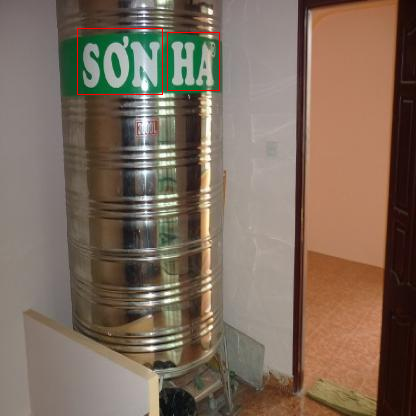



im1876_jpg.rf.c57f9245af23068751badb0ec4b8e6e1.txt
TẾC
University
National
DA
QUỐC
Economics
HỌC
DÂN
KINHI
TRƯỜNG


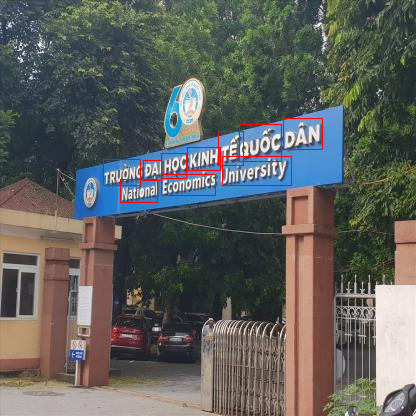



im1583_jpg.rf.6c73495a13cc66e4c299e9650932a959.txt
1
1749
Xanc
11
c
00
túc
FIT
mc
050
Sỉ
0175
Nga
Lẻ
cấp
Vất
công
15
orloom
cuing
trình
NKAY
VLTH
Chuyễn
PHÁT
CẮT
tư
UỐN
ĐIỆN
KIM
KIM
KHÍ
HỚI
NƯỚC


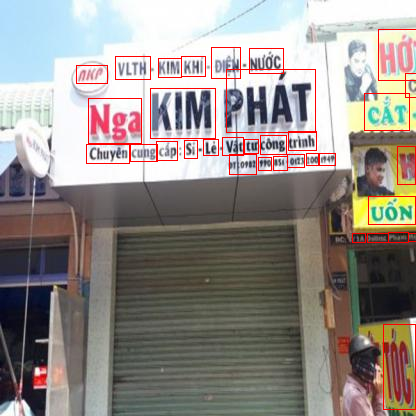



im1718_jpg.rf.f88c48f8b7353f12c9ab03c06a3c9f63.txt
N
M
nh là
5
Già Neo
D
Nelx
Va
Canh
Multimela
Viên
Đoàn
Arena
Nhân
Đi
Học
lét
Tâm
Già
Viên
Trung
Đơn
Chuyến
Thăm
Người


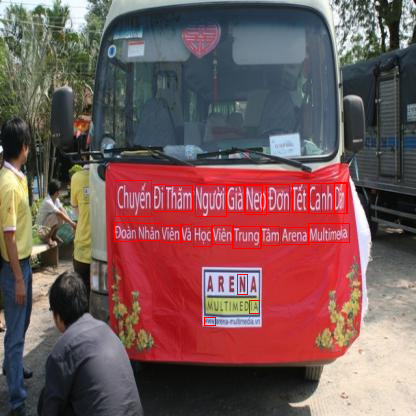



im1255_jpg.rf.3468bb57e654a35b6eb5b61555e2a34f.txt
Anh
Wax
TỐC
Làm
HỌC
Dự
VIÊN
DAY
Xăm
Mặt
CẤP
40k
Điểm
TAO
Cắt
Dâu,
Gội
Vẽ
Nối
Mi.
NHẬN
MAKE
Nách
Mi,
Massage
Dầu
Móng
Dad
UP
Đầu;
Móng
Mắt,
Trang
Uốn
Văn
Môi
Chuyên:
Tóc;
Cô
Hấp
PHUN
Tiệc
Bấm
Tóc;
XĂM
Mài
Thắng:
Duối


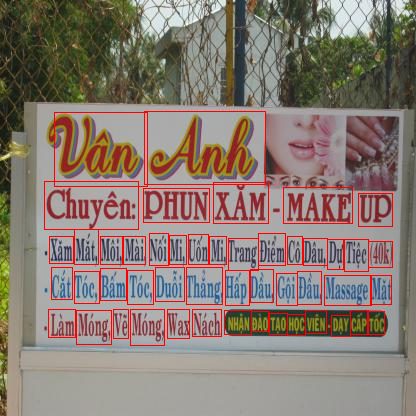



im1164_jpg.rf.1d31e7977c1f734d5c003ed41bae30e6.txt
munic
2
root
K
Ex
Bần (
DONGS
Fươngs
ANH


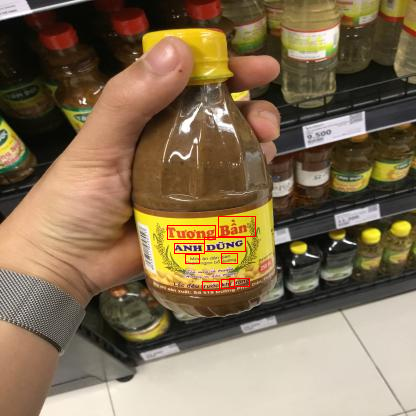



im0117_jpg.rf.efb5bbace3e75db1e139fc63c2f14459.txt
HARLS
UTIP
ii
IE
TỪNG
BẢN
CẤM
H
11


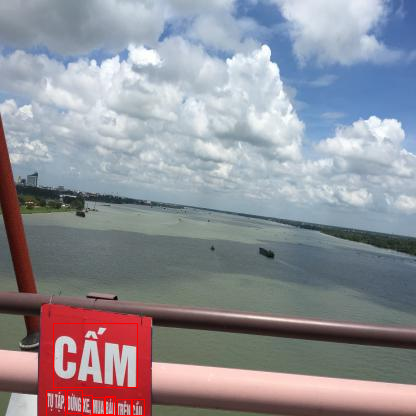



im1892_jpg.rf.cce8828acb93a0a2b47d02dce02b8407.txt
17
2007
NAM
VIẾT


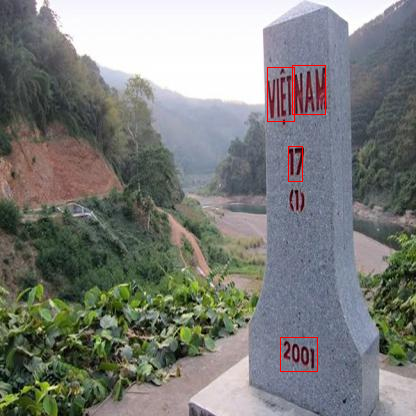



im1904_jpg.rf.b5ed3fd77b7f7f7109a11b29b05c93fe.txt
83
0918
DD
DTB
545
VP
B52
0708
QUAN
KHA
CÔNG
CHỨNG


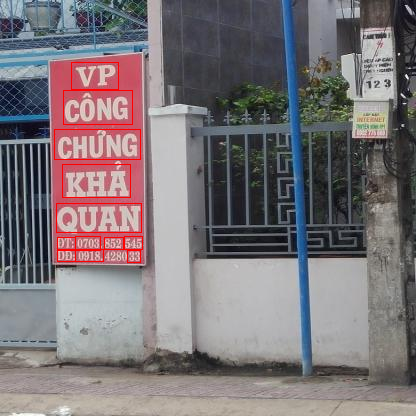



im0804_jpg.rf.c02917121c2cde420d25eb77e817a6e7.txt
2
17
NGA
TÂY
2015
NINH
MOBIFONET
Lẻ
LỄ
NINH
CỬA
KHAI
HÀNG
BÁN
TÂY
TRƯƠNG


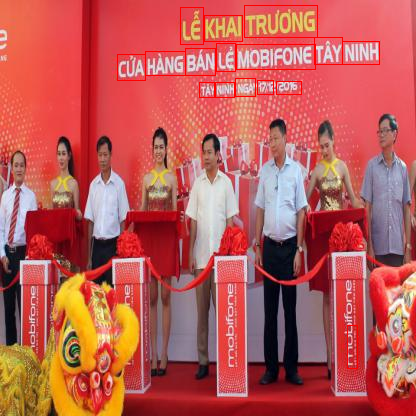



im0091_jpg.rf.24fb37d1e99dc85a259045f0df06cb8e.txt
ẩm:
6 TẾT
33
80.000
GIÁ
7
GIÁ
cũ
TẾT
33
TỪ
6
50.000
60.000
29
TẾT
LỚN:
ĐẶC
TẾT
80.000
BIỆT:
THẬP
NHỎ:
MÙNG
CẨM:
MỒNG


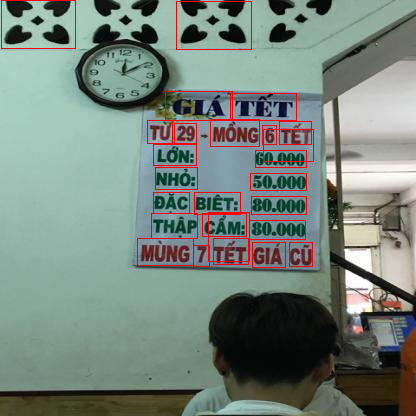



im1998_jpg.rf.ca3f67aa7eb95b1e85e2510a1dcd1883.txt
G
2
01
A1
GIỚI
PC
TỰ
páno
Ban
MOT
LA
CAC
EM
PHAP
CUA
EMI
THẾ
VA
MANG
GÁI
KHÔNG
TRAI
MÌNH
THAI.
CÁC
NAM
PHAN
PHÁI


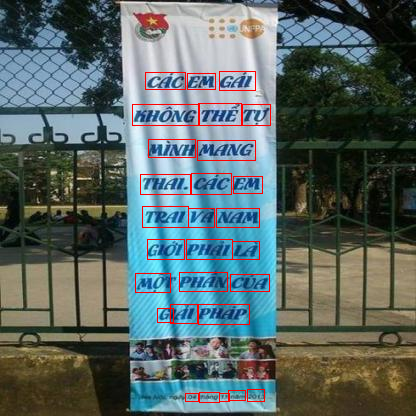



im1598_jpg.rf.003e90f064c4d8c628c2a0acd4515474.txt
1
noo
man
HỌC
KNOP
DA
SAU


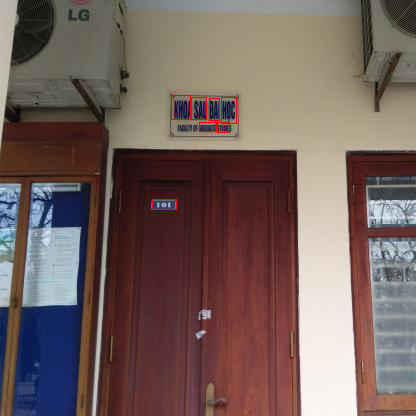



im0646_jpg.rf.042bdc3f7cab11640ecd5905547d45f2.txt
19
No
MT
Nz
parided
ENA
lài on
M
pletsear
2
malannin
Ke
on
1
Lần
11
ý
Please
Elet
seat
cách
cầu
hâx
Chú
Ngòi
ứng
bon


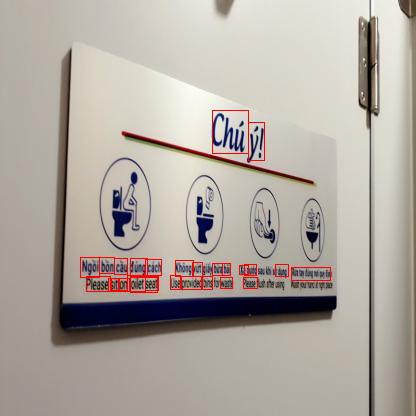



im0978_jpg.rf.30362b46125e059c50126c6ec93744cb.txt
NGA
XA
3
VI
C
số
LIÊN
CUM
CUAT
CHU
TICK
VA
MINHI
CÁC
CHI
HO
sở
DON
ĐAI
BIỂU
CÔNG


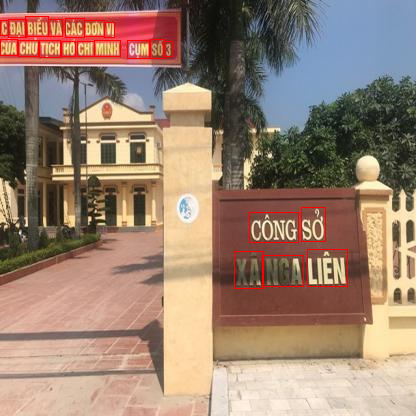



im0289_jpg.rf.1a4067b419836a6be98f7887df150711.txt
01
THÌN
NHÂU
TAT
DAT
HỌC
CHÍ
TRUYỀN
LẬP
VÀ
TUYÊN
ĐẢNG
XUAN
BÁO
THÀNH
NAM
CỘNG
SẢN
CHÀO
82
VIỆN
NĂM
VIỆT
MỪNG


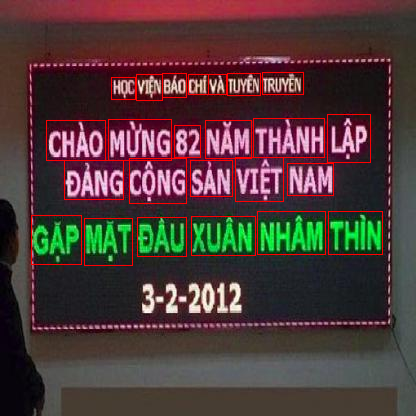



im0987_jpg.rf.4b7c8bbe5c3aecc07d8e893f352830a8.txt
E
ULA
03100000099
ANNIE
1
HAST
1019
CON
Network
king
TIỆC
KẾT
NOI


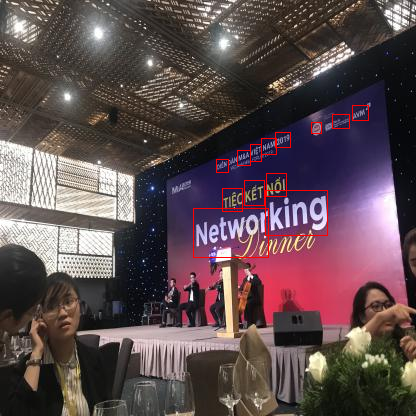



im1748_jpg.rf.826670476cbb44e8aea6be625ac49817.txt
191532
TONC
KH


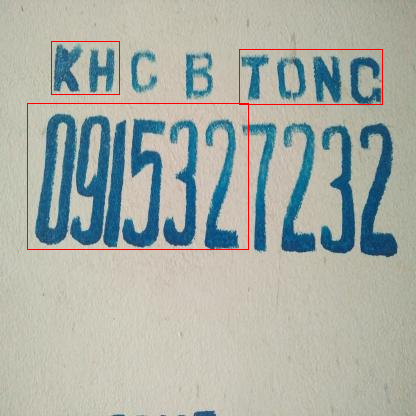



im1037_jpg.rf.b16041414cbbf10f48461ce1b626779a.txt
có
1
11
Đị
Bắt
Được
Cân
Đàm
1
Đề


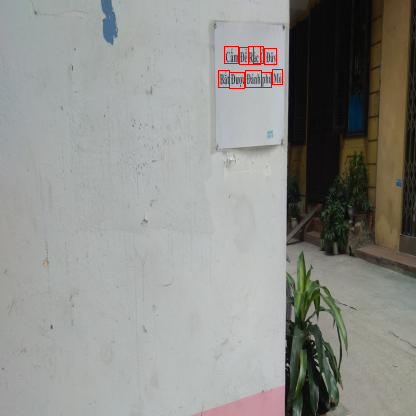



im1488_jpg.rf.d8a4bf9a1ffe6f7eb7c08cf4d6110b75.txt
1
X
THEY
RANDY


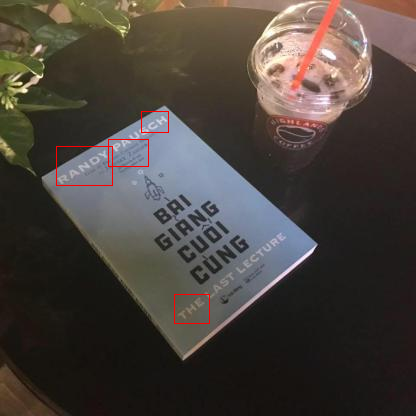



im1125_jpg.rf.8297f72ccf6bea093b9a73fff2da9b30.txt
STATEN
THUC
Slim
REST
PORE


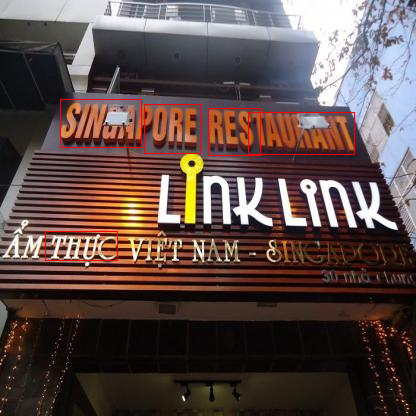



im1590_jpg.rf.78b9f4488fab16baca12496513d4bc9c.txt
14"
14
FLOOR
TẦNG


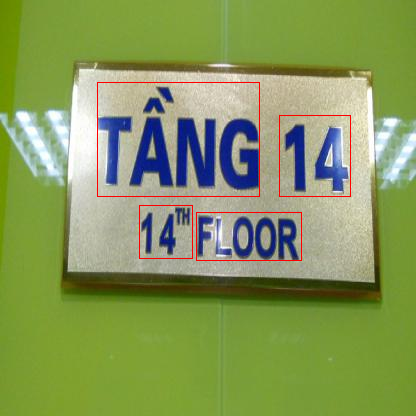



im0126_jpg.rf.37d0605bfa79e6cd1641346b1ec68146.txt
01.090L550
Misale
Dugrue
pc
12
304
365
ĐƯỜNG
CÁT
KP:2
P.MỸ
Xách
Till
BẾN
owp
1
Thời
PHƯỚC
Trang
Em
Trẻ
Giây
NT
Nam
Dép


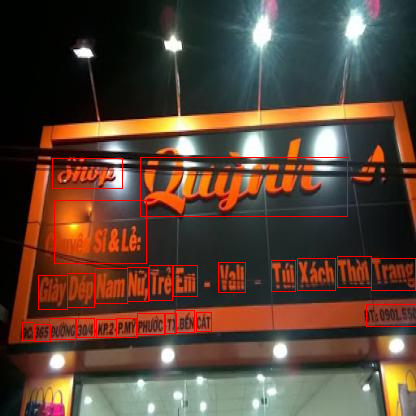



im1286_jpg.rf.2e4538a0f5189021c60e130da7860bbd.txt
TO
ulich
buondons
gmail.come
019
3783
3783
C
0500
020
Fax:
CO
ĐT:
A
Emails
Lăk
NHÀ
Đăk
Xã
Huyện
Đôn
ĐIỂN
THAM
TÂM
Tỉnh
Trí
Na
Đc:
DU
TRUNG
LỊCH
QUAN
Buôni
Buôn
ĐÔN
BUÔN
SẢN
Krông


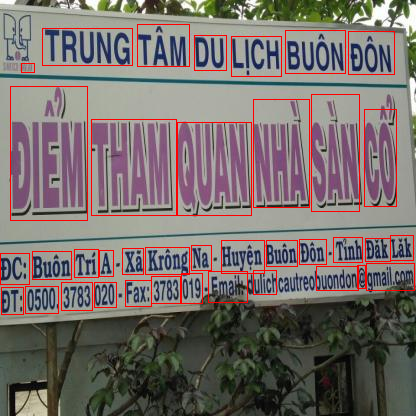



im1151_jpg.rf.7527fb290a58215ed2f20715673764a8.txt
ĐIỆN
TY
TRUYỀN
EVINNPT
TRUYỀN
CÔNG
NỘI
ĐIỆN
TÁI
TÁI


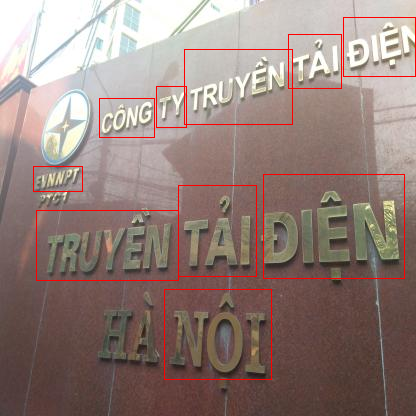



im1514_jpg.rf.f650bbd5289fd5aab315cbda40c3eec8.txt
124
F1
10918.889
ĐT
Chuiên:
TPVL
DCI
NGUYỄN
ĐƯỜNG
NHA
DÉP
VĂN
THAO
GIÀY
DÁN
THẾ
ĐẾ
SỬA
GIAY
NGỌC
THAO


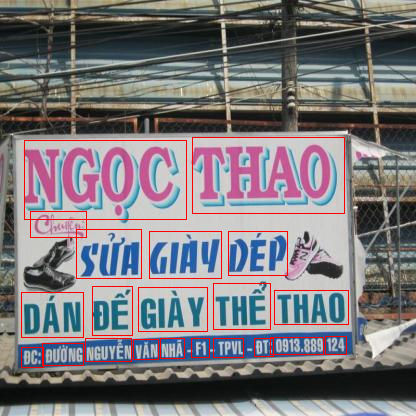



im1832_jpg.rf.74a2b6e2a002bcbc8ade58e3a368f27b.txt
ANH
ĐÔNG
ĐỊA
PHẬN


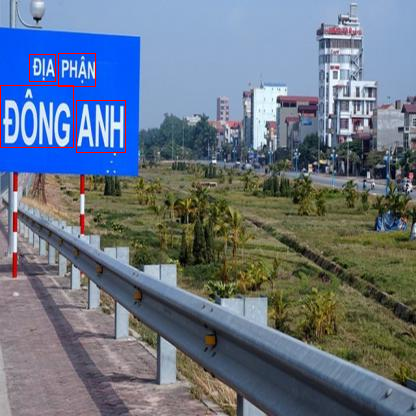



im1282_jpg.rf.100ff94ca3767cd2ff6fc77de7719a20.txt
VI
HIM
ps
UN
RON
INGONG
Gu
icroeal
KEM
D
MARCH
Met
MIM
SUA


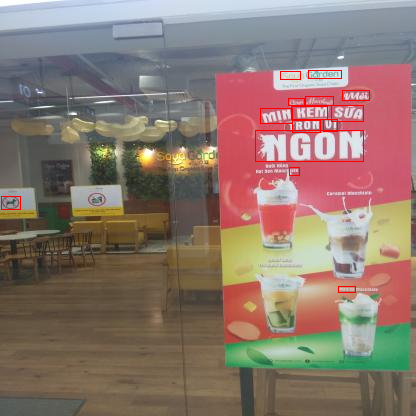



im0847_jpg.rf.fd77e9e9407b4fc607dbd78148b6cf2c.txt
Exponds
NAI
HANA
AM
Lầu
QUỐC
Mi
HÀN
CAY


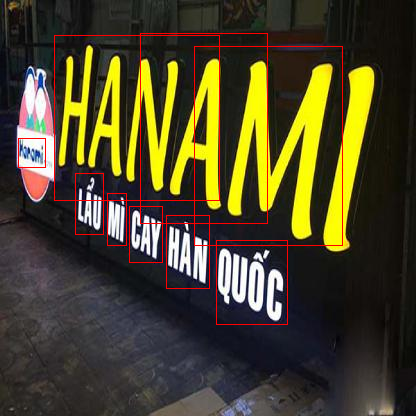



im1198_jpg.rf.75904e3714dbea423011630b783bab37.txt
HỤ
Mai
TROAT
IA
Bạch
Số
Gốc
CHỮA
10
Kinh
EP
KIỆN
ĐIỆN
SỬA


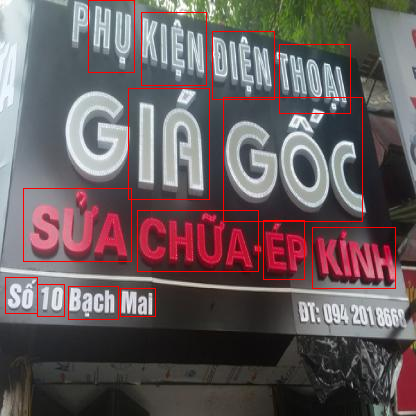



im0703_jpg.rf.5aea40a019bfb0424e04fa378b464c5f.txt
Fno
Low
Thoach
Bật lên
sức
tung
manh
hoan


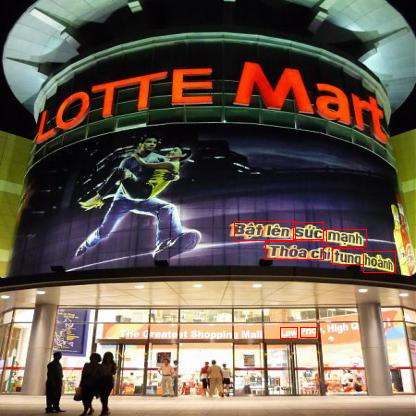



im1310_jpg.rf.465ca1caf59eeb228cbca744082794ba.txt
Lvc
SB1
55
1
14
VÀ Y
W
LẠNG
LAY
pax
NUON
SON


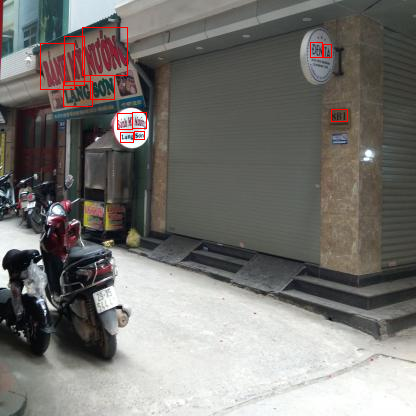



im0234_jpg.rf.6ed61be53f3f8abd82325c1bbf060153.txt
HOTEL
BIỂN
SAO


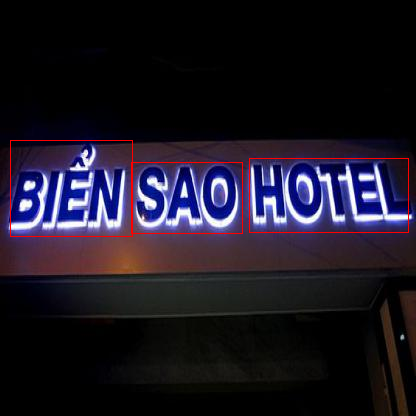



im0691_jpg.rf.fcb1238dc86b816793941bfb46d9fdf6.txt
0703.825
VĨNH
Ipz
AMPLI
TP
C
TRUNG
HỮU
HOAT
TIVI
BACHI
KARAOKE
TAM
AN
DVD
Cán:
THÙNG.
LOA
MIDI
(huyện
DIỆN
MÁY


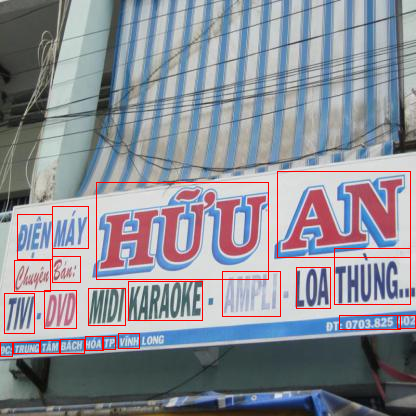



im1588_jpg.rf.842eb8f2274d204e0f063649646f7f8d.txt
COMMITTING
Chang
quán
change


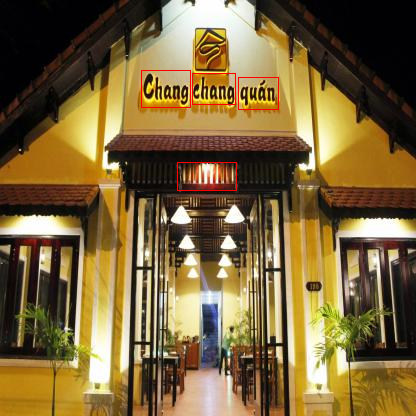



im0767_jpg.rf.54de9ad0a14a0f05057f0810f3d26a58.txt
HẢI SO
CHBẤT
BIN
GROUP
ĐỘNG
1
HẢ
HAISAN
TÂM
RUNGI
Bộ Quốc
PHÒNG
soi
TY
HÁI
TỔNG
CÔNG


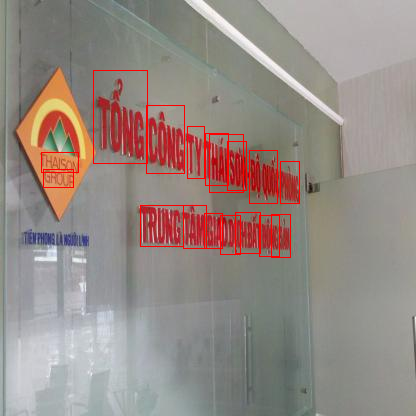



im0966_jpg.rf.8cb90b945c09ed066b62c6c7275ea724.txt
GIÓI BIỂN
HUN
SEA
GIÓ
BIỂN
KHU
MH
AREA
Boundary
BIÊN


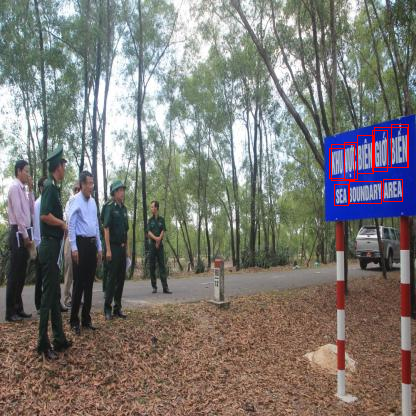



im0747_jpg.rf.ab7c67a3f4a59e7463bcd708f6646dbf.txt
B
HC
DOANS
Xic
gui
SING
goóp
ấm
XIO
E
TÍCH
KY
CAUT
TAKINORIA
SAN
ROTO
CHUYỆN 1
KHÁCH
SHYBATA


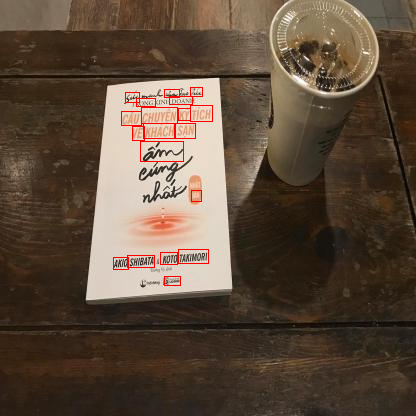



im0806_jpg.rf.ed590db49d85228e57fa7271cbd1cd49.txt
102.81
102
X
18
19
DI
NBS9
Dies
676
900
TAL
Mos
mi
TẤN
KU
HƯNG
CỬA
GỐ
HÀNG
ĐỐ


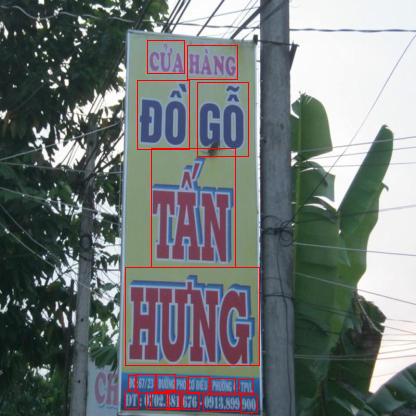



im0237_jpg.rf.f17601efda5474da02650e9932f4be04.txt
W2
K
DIE
W
RS
NX
IE
El
H%
15
EL
Hore
FT
11
LUCING
11
RON
LÃO
PHẠM
NGU
ĐƯỜNG


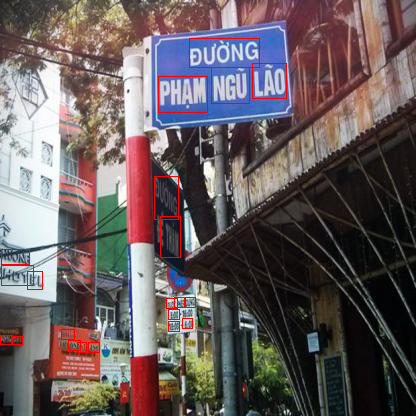



im1836_jpg.rf.441558e53bdb48dc7b41fcba09be6087.txt
HÀNG
328598
bins
Janyans
9
Unprunching
01
1
amx
52
711
senals
U
316
PHUMY
ZPMHI
n
BT
MASTEN
SCO
Gian
3837
5911
BÉP
Emats
CAW
9
55
INNY
HUNG
7
Chinh
X
GS
15
155
HUNG
163
Mọi
32
PHUL
Không
MỸ
Phụa


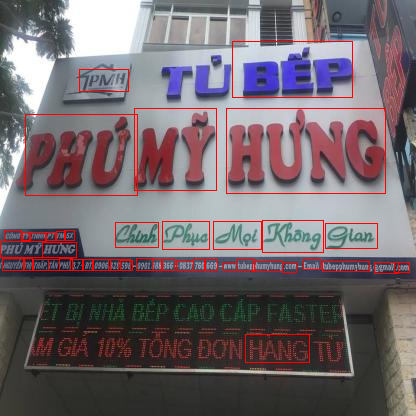



im1087_jpg.rf.894c26653daba250ed926a72174210c5.txt
MITAN
TG
Hy
Lần
CÙNG
VŨ
KHÍ
LIỆU
VẬT
AN
ĐẰNG
Hồ
Nữ
BẠCH
PHƯỜNG
ĐIỂM
THU


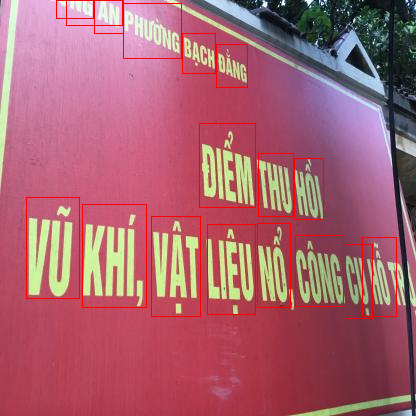



im1188_jpg.rf.de6ca51518f8829b662cb0054da22b30.txt
LYNIEM
Nam
201z
KHÔNG"
TY
DIỆN
40
B.52
CHIEN
TRỀN
PHÚ
NỘI
HÀ
THĂNG
NIỆM
BIÊN
NĂM


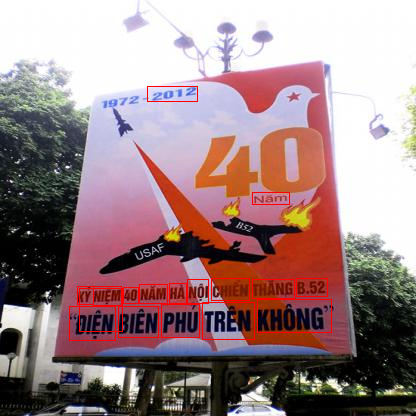



im0988_jpg.rf.6c88e959f83aa2281072e3125738739f.txt
50m
ĐẠO
4
MB
MB
TRẦN
HUNG


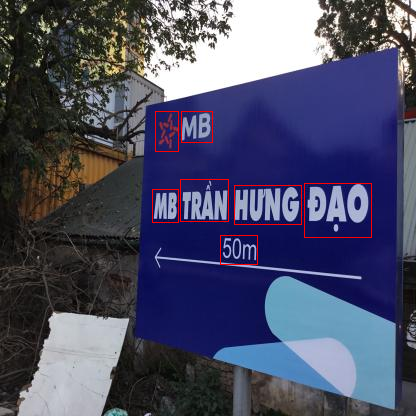



im0250_jpg.rf.b04878c69663559710e15b095345518b.txt
OPENT
PENING
ONG
KHA
BRANG


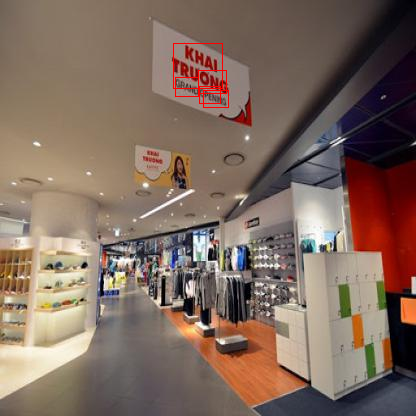



im1148_jpg.rf.1f9a0f4eed3064d736e8565d1e7328cb.txt
M
Eu
WIT
Tinh
V
INCRETERCITING
11


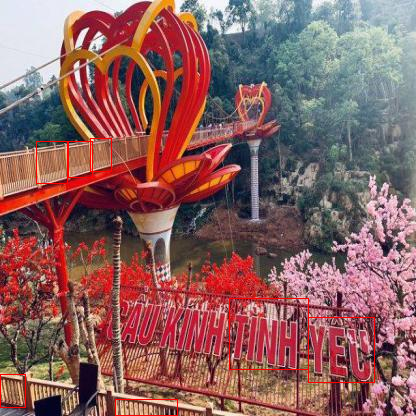



im1886_jpg.rf.6a5b1298929551e8c368a33084cfcb20.txt
XE
ĐỒ
CẤM


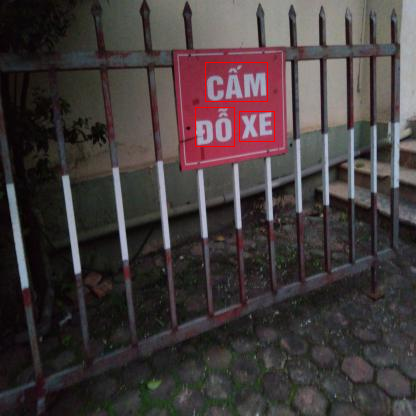



im0107_jpg.rf.b7bdf3750b55bb7a07c41e11e18b3fe3.txt
EXIT
Boarding
Gate
BAY
RA
CỬA
TÀU


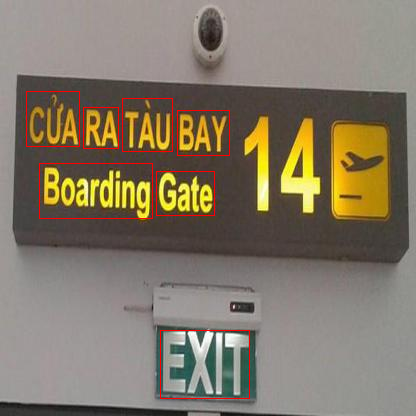



im0304_jpg.rf.f36c087a951b762883bf0f8f7ed0553b.txt
Distractions
OF
1
Tâm
Tổ
infloce
Cá
Sáng
Bun
Sản


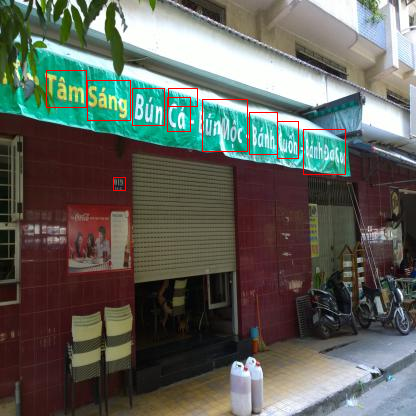



im1291_jpg.rf.3f366d19c905ddf8398d7ee332090b04.txt
VODICH
ĐICK
12
ME
N
1
V
WI
Whay
DICH
VÔ
NAM


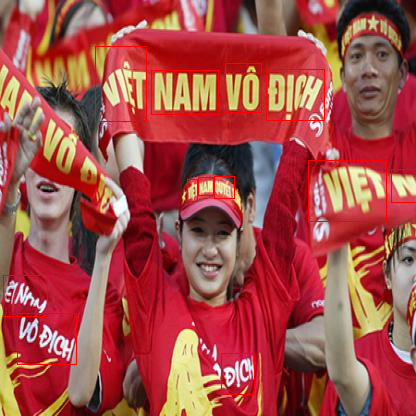



im0692_jpg.rf.503cf06ac5b6581fe23cd1ae1c49db5c.txt
HIỆU
NAM
NHÀ
SACH


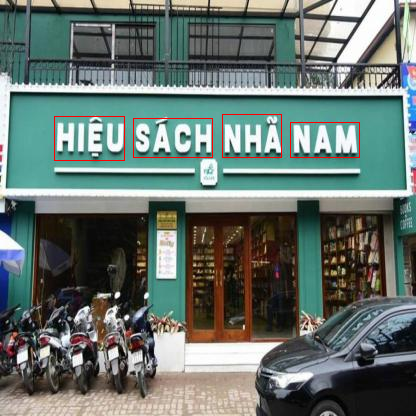



im0718_jpg.rf.eae61e0717ca65b86f12168bfd35fcf9.txt
SỐ 3
tế
YÊN
Mont
SBRUFZ
TRƯƠNG
LƯƠNG
Trương
quốc
MONTESSORIE
non
SAKURA
KHAI
mãm


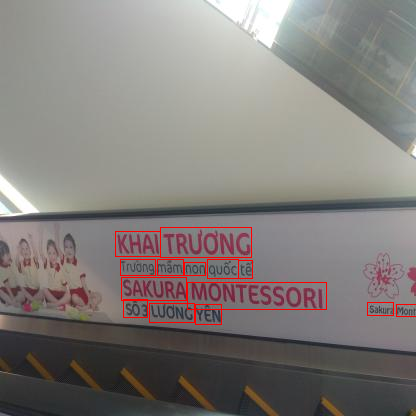



im1878_jpg.rf.7cfa4c609c2f4bc47c7707742bbc7727.txt
Roz
MỚI
CHÚC
MỪNG
NAM


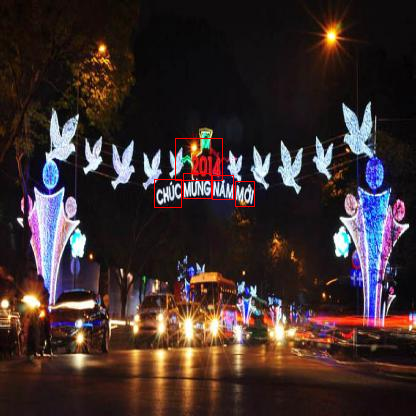



im0104_jpg.rf.c09100868db28ffdc1d34ea421b34887.txt
LONG
RESORTS
CUNG


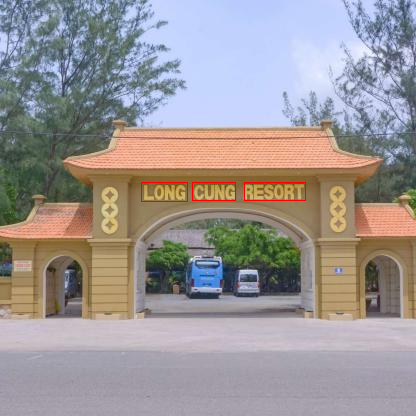



im0607_jpg.rf.0f3fb0291e3c76b8a1862c279c1761ac.txt
Unphyocvan80.corous
Ngọc
Văn
Si
Bán


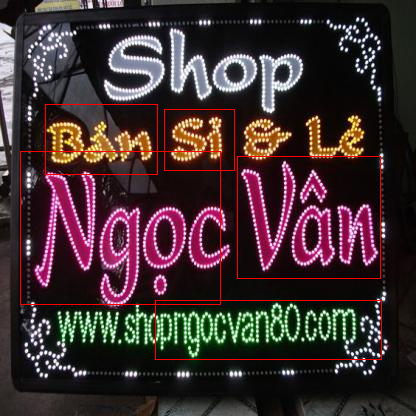



im1105_jpg.rf.51d7c3f7b40ea59bd0fe7a1758649a10.txt
Micm
W
TIỀM
AN
900
VIACYT
N
1
HAY
555
VNVCI
TRUNG
VNVC
HITING
TIÊM
CHÚNG
TIÊM
TÂM
TAM
TRUNG


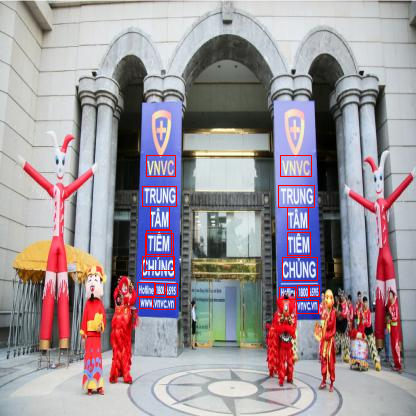



im0872_jpg.rf.4f4ea238565b903c9469694d5f406e81.txt
29
N
Lay
PHU
368
5
000
CONTING
CANNY
Cây
LONG
LOU
Lươn
1280
NHUAN
PS
OPP
BEER
ĐỒNG
DANOT
0868
PHAN
NƯỚNG 1


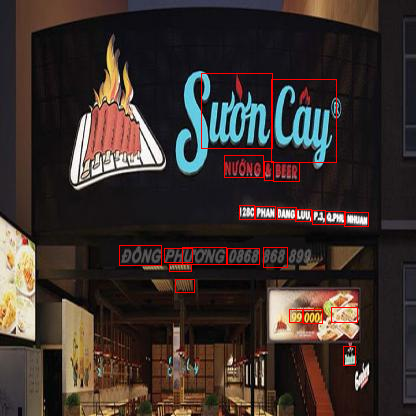



im0142_jpg.rf.f3a4b7b70fa7188561651d3959123681.txt
B
15
UN
31
DƯƠNG
KIỆT
Tốc
QUAN
CII
NHU
40
VO
TẠO
TAN
CAO
VAIL


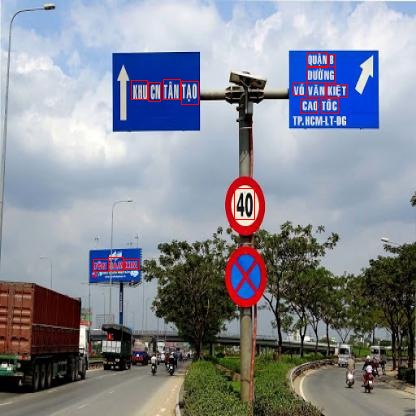



im0282_jpg.rf.36a6a65b525783b147327e521f689e61.txt
mw
Inters
-ATM
Đ%(6
11
BIDY
TỰ
DỊCH
vụ
HÀNG
ĐỘNG
NGĂN


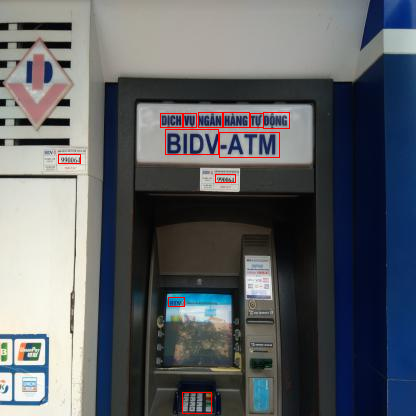



im0864_jpg.rf.e650f8e3d3917d0b9c12e758f5e56133.txt
UZR
HEONE
HOG
m
DAH
KHOA
NAM
CAO
TỰ
HỘI
ĐẠ
CHỦ
Xã
HỌC
30
TỔ
CHỊU
ĐAMI
HANGI
ITOA
VÀ
THAO
Vực;
TIẾN
TIỀN
cứu
KHOẢNG
ĐỊNH
NGHIÊN
TRÁCH
HỘI
Lĩnh
NHIỆM
HƯỚNG
CHỨC


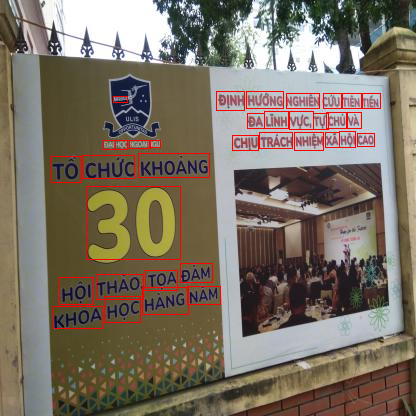



im0849_jpg.rf.f09cae6f46a8611f7a50ef5ed6eafe90.txt
Mac
1
2
5
S
1
3
1
LD
E
F
3
BIET
ĐẶC
uc
LY
KHU
CÁCH


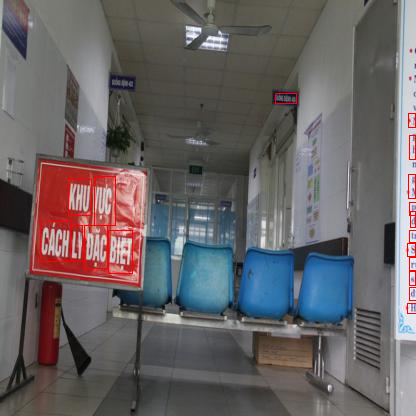



im1545_jpg.rf.a53e59102bae2aa8cf8c8ea4e3c0e6da.txt
MA
18
PHỐ
16
HỒN
NGÁCH


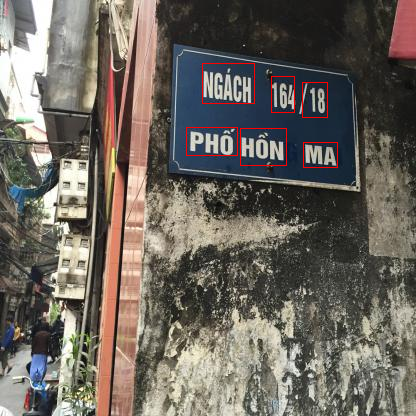



im0549_jpg.rf.6cc91badd8ee92019600f7dede981f7a.txt
me
hun


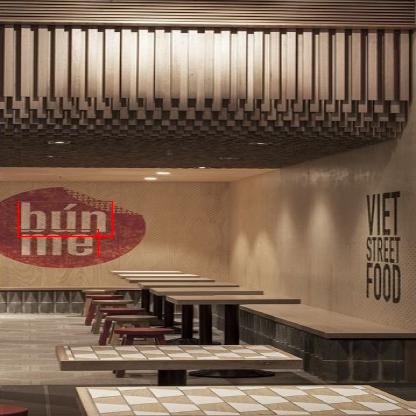



im1707_jpg.rf.6700100454aca2a590cc818582e69a24.txt
GAM
VI
HAY
ANH
LONG
HOA
THU
BINH
NOI
HUNG
FRO
NAM
NGANI
THAKED
ho
VAH
HIẾM
THANG


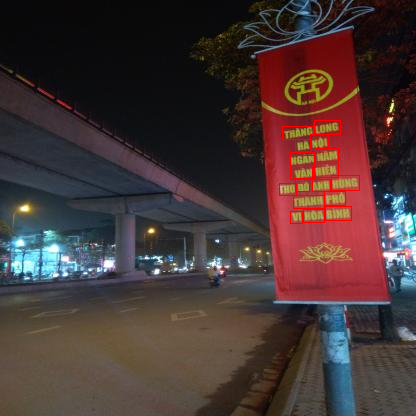



im1727_jpg.rf.cacd51d3a710eb0c2f3f523ca831a518.txt
20962972683
to
si
đồ
si
Lẻ
cao
và
cấp
Thùy
Welcome
Chuyên
Phương
Shop


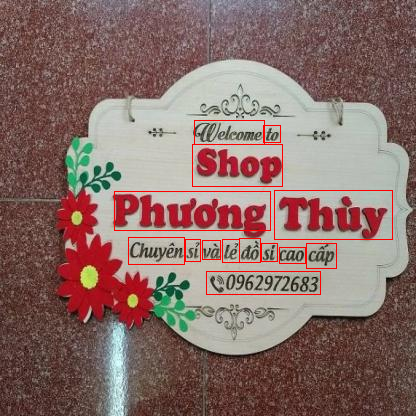



im0875_jpg.rf.8860e7322de263107f5a63a79086cb3c.txt
ĐỘI
ĐI
XE
MAY
TRẻ
BẢO
HIẾN
KHI
PHẢI
EM
MŨ


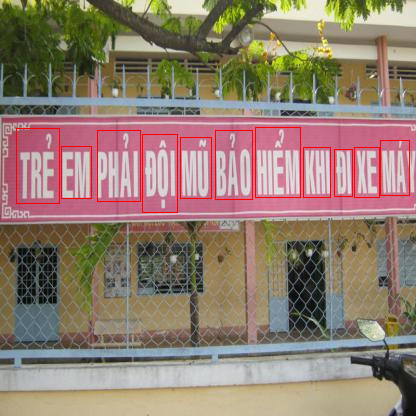



im1143_jpg.rf.9d414d829a3354f7ba831dcee6a6b48c.txt
BAIL
BC
PHIA
47
0,11
0969.44
33/a
35
DIB
NON
VA
THANH
HỒ
MỸ
ĐỨC
MUA
LONG
THANH
cũ
XE
các
BÁN
LOẠI


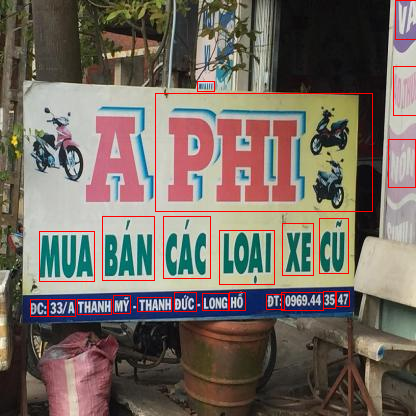



im1416_jpg.rf.3c1ee6c17a7d1edcbbc175d1f1bb28b9.txt
THUL
LONG
BÀI
VÀ
PHAT
TRUYỀN
THANH
RINH
VINH


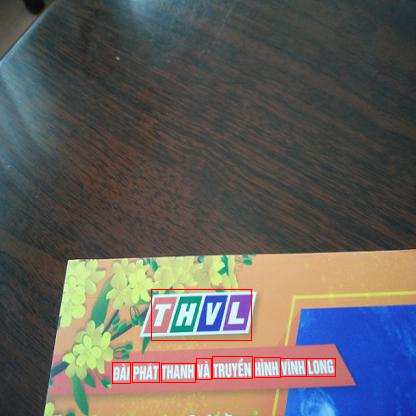



im0845_jpg.rf.f68bb90293c68160eb3df6899d61597e.txt
Ausin
OFFICE
VĂN
737
00468015
0646.891
Tel:
PHÒNG
Fax:


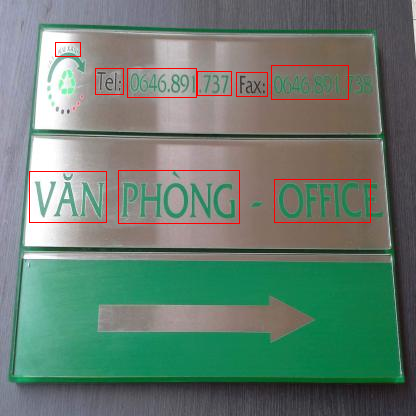



im0956_jpg.rf.07b5f3ce865c48ea57dd7c4537197876.txt
GIA
QUỐC
JAT
MAUL
MỐC
CA
ĐỘ
TOA
MUI
0001
gps


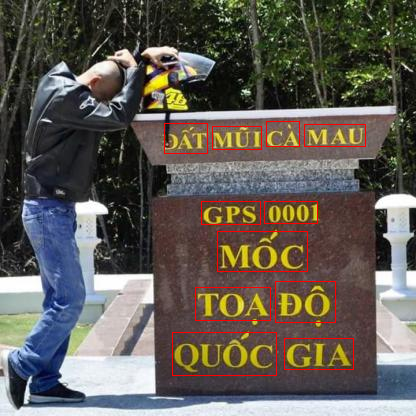



im1159_jpg.rf.18b54ebc8f8ce8a19d256bbb1fde7b32.txt
KHAMS
ISM
Truang/Trung
VỤ VÀ
GIẢM 2
08:08
qv
150
2018
09
X
VIET
TẠI
NAV
WIC
IRC
05
2018
CAFE
20
1
09
Nu
08
2018
50
TIỀN
ai
08
ngay
Co
08
CHI
CA
ngay
ngly
Un
VÀ
Các
DỊCH
VU
1
TRÊN
K
HO
Jamani
SAN
Amang
BAT
Trung
PHẨM
TRƯƠNG
TỪNG
NGÀY
30
KHAI
BỪNG
GIẢM


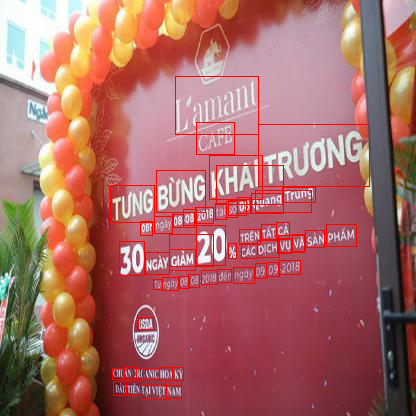



im0041_jpg.rf.b957186882710373cc6ea57823fbd34d.txt
HÀNG
HỌC
CẤM
TRƯỜNG
KHU
BÁN
VỰC


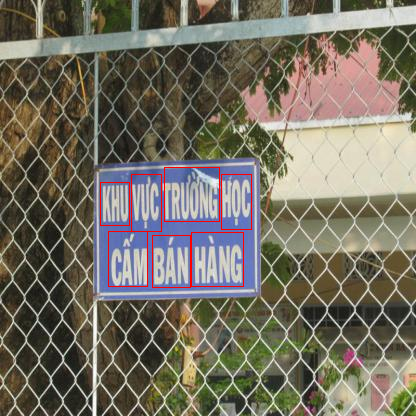



im0454_jpg.rf.3429afb9581eb490bb2ebcf20dae0ec2.txt
BA
VƯỜN
QUỐC
GIA


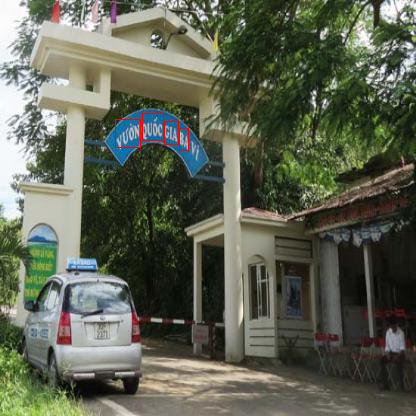



im1997_jpg.rf.68b8b07d6f858400387d4a9d67008f55.txt
00%
Im
Welcome
01
Imps
sixing
9
caoo
503
2
10
11
0129
m
LUGS
550
com
ph
Store
W
H
0912
wv
BT
Boch
JA
08
62
BTSIOIC
BN
Đer
5
elan
19
08
23
NI
le
ponh
Nom
100
cax
naw
GS
ICH
00
NGAY
200/2017
11
BT
GIA
TRIE
hàng
TANG
NHẬP
DUY
MI
THAM
10'
HAN
1995
TANG
THUỐNG
001
SET
MHAT
KHẨU
GIA
QUA
THE
PHANT
PHÁM
Store
VŨI
QUA
Chuồi
KHÔNG
BT
HANG
DON
200K
TRƯƠNG
KHAI
HÀNG
BIÊN
TREN
cửa
BUNG
GIOI
ĐIÊN
STORE
CỬA


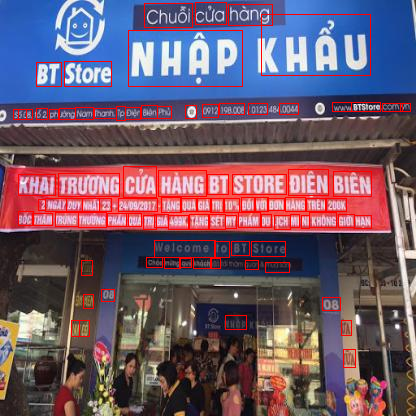



im1907_jpg.rf.77f2c8f24851be643e18791802762c3b.txt
molt
LING
EST
pugs
MOON
NHU
CAKE
LAN
THU
TRUNG
BÁNH


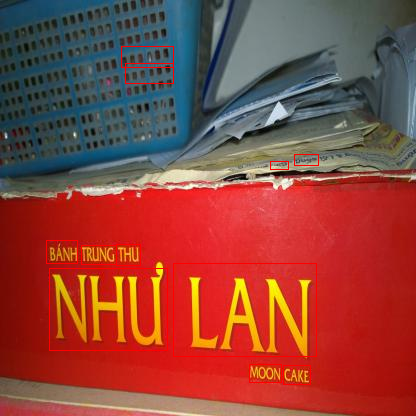



im0072_jpg.rf.49bbf21ce5da0d0e2c66410412e88126.txt
MON
Uni
avo
điền
QUAING
QUITE
QUON
IP
MÁY
Omani
TINE
Slore
Anh


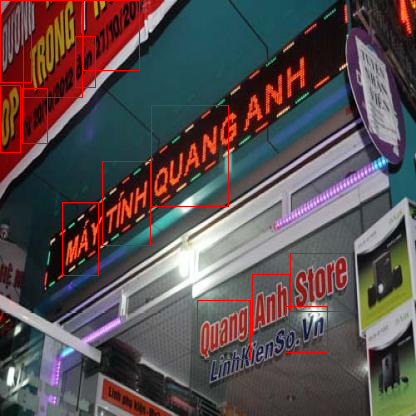



im0865_jpg.rf.48a70587f93216acd137673b18fd3a69.txt
understay
ano
meme
iren
hiếu nhưng
persition
embrize
Stimulated
contessors
potential
magi
plation
childf
inb
pallables
nữ
promote
avit
bệ
to
and
Tiếng
to
themb
Ties
thetr
help
the
force
aim
đẩy
tưởng
With
có
của
trẻ
ghii
trí
nhớ;
sắn
tượng
không
khơi
phái
trẻ.
nhưng
Mục
năng
đích
kích
tiềm
trẻ
hiểu
cho
thích
dậy
thúc
buộc


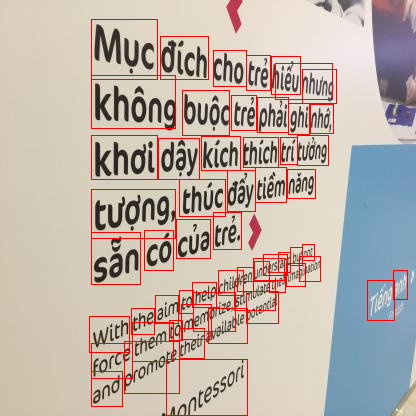



im1735_jpg.rf.b6c1aca4545ed21e827cf2aeb1e1b3ef.txt
5
Ilkm
4
5km
BAI
Thai
Km
TẤM
Hotel
HÀ
TỈNH
THÀNH
XUÂN


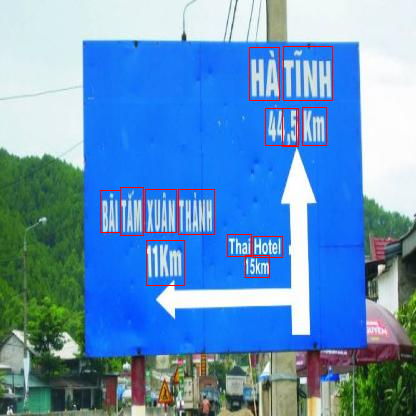



im0577_jpg.rf.8a14f04a7f5f12a7677fe15b545ad98a.txt
STRIPPING
03
TỪ
BH30
NGUYỄN THỊ HOA
SANG
9H30
TỐI
ĐẾNH
HUE
MO
CUA
GIỜ
Lụi
Bún
Nem
Bò


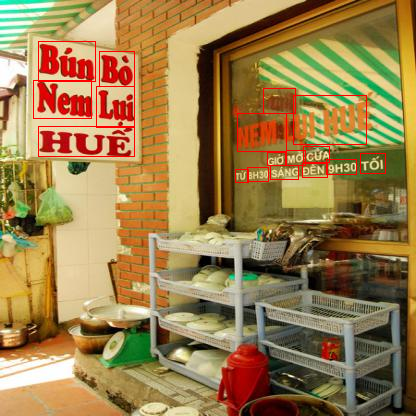



im0366_jpg.rf.059233ad06c3ca8dcd3ed9d2e0b5f4cf.txt
M
BẮC
MINH
INTENT


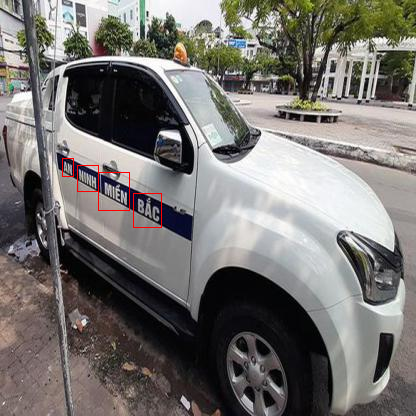



im1431_jpg.rf.df515080cb7226009593e12882398bd1.txt
USZ
Jam
WARM
mc
Tenkens
THANHS
bist
XUÂN


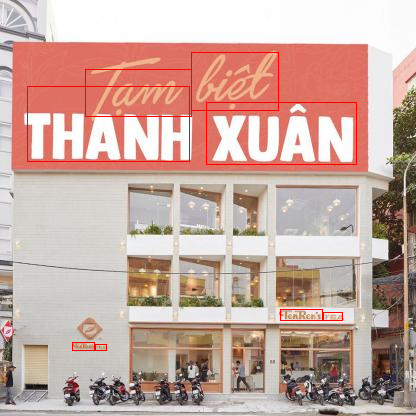



im0968_jpg.rf.4c0fd8d7147f2eb096451f2f69b760d2.txt
AN
010


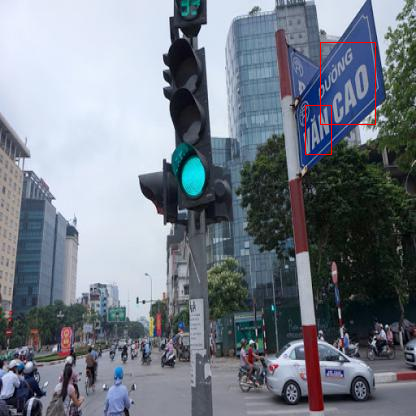



im1435_jpg.rf.6d0b8f8c0f219b732fe48ce73afaee67.txt
Inte
E
E
Q
10
JU
9
V
ngày
Nội
In
0
12
16
DUG
quốt
2016
GIANG
HỌC
HỆT
DÂN
KINH
TRƯỜNG
Lố
Hà
BAI
GIAO
DAI
58
KHAIL
QUY
HỌC
CHÍNH
KHÓA


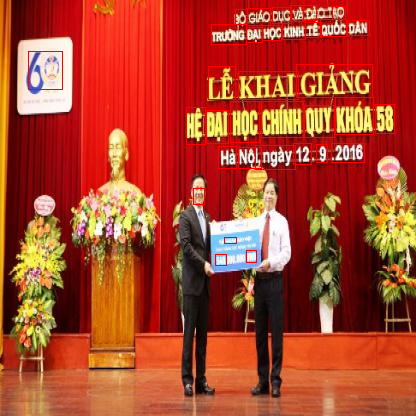



im0341_jpg.rf.7aecc507adfe355e8870425615a543cd.txt
VARTIE
DEIT
Cap
Khi
Lr
cũ
ANH
CAMERA
QUAY
NGAY
PHỤC
THE
THẾ
Anh
NGAY
CHẾ
LẤY
ẢNH
LẤY


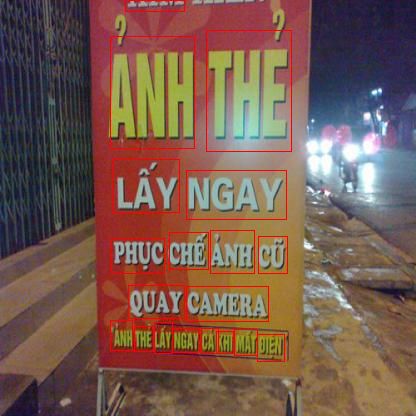



im1705_jpg.rf.fdde95abd40655f7859a3d2a9608a463.txt
KHO
Ky
THUYỀN
Kill
Nai
HÀN
ĐƯỜNG
DƯƠNG


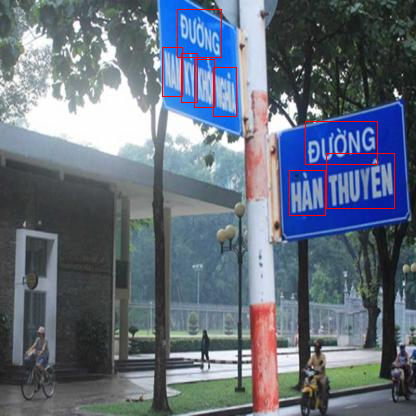



im0494_jpg.rf.3db6ee3ae2aad93110f60ace41925b5d.txt
L
Thế
901
DII
Giầy
Giới


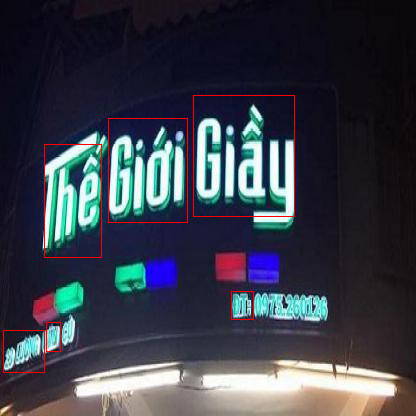



im1031_jpg.rf.e61a9c1dcade5ef9e0e56ce19e557f47.txt
MINH
HỒ
CHỈ
TẬP
ĐẠO
THEO
VÀ
ĐỨC
TẤM
GUONG
ĐẨY
LÀM
VIỆC
HỌC
MANH


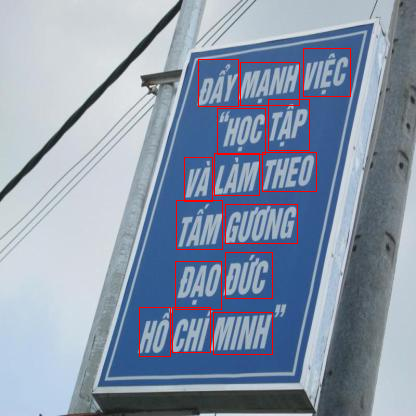



im0939_jpg.rf.9bde293bcbc2a11b7d5fbe70a91c3bc8.txt
85
JUNIV
CHOBBERS
8
11
gn
ĐT
ZIN
D
C
FAX
567
L
THIỘT
1
11
MANISTRY
DUC
r
NGUYỄN
Đảo
BỘ
BUÔN
Tào
DUẨN
TRƯỜNG
TÂY
GIÁO
HỌC
ĐẠ


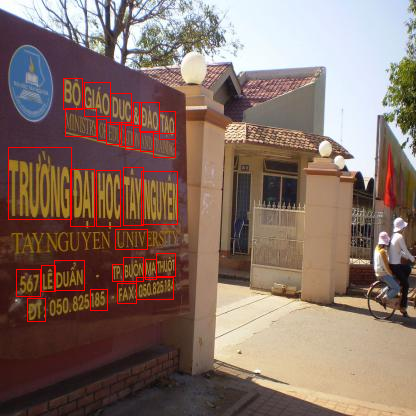



im0124_jpg.rf.7cec9d12325e0d242534074d1547cb54.txt
070
1885281
270
882EE2
DT:
F4
TRANG
TXVL
PHẠM
FAXI
11/91
MAI
THÁI
BƯƠNG T
NỘI
THÁT


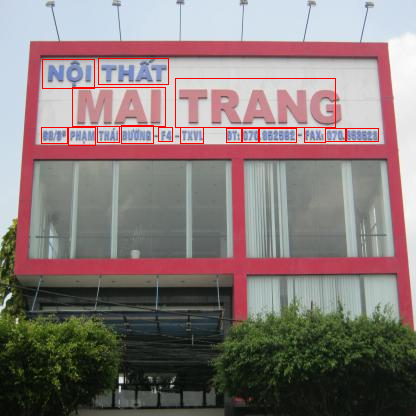



im0281_jpg.rf.70a6e2e0cb3d62cfbc76a803167f4526.txt
CHẶT PHÁ
1
Mangs
CẤM
recomming
Về
evanta
VOASTS
for
THẢI
Đổ
he
SẢN
RÁC
huture
THÚ
XUÂN
ĐÁNH
PHÁ
THỦY
BẮT
CHIM
TÂN
SĂN
BẮN
RỪNG
CHẶT
RỪNG
NGẬP
MẶN


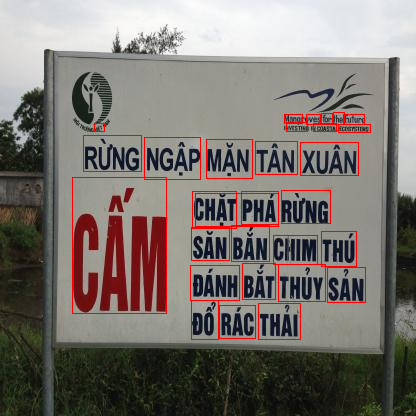



im1512_jpg.rf.bebb20cb0aa1c0a16d0cc6c67765e396.txt
0583.6
0905.87
871198
39
4711976


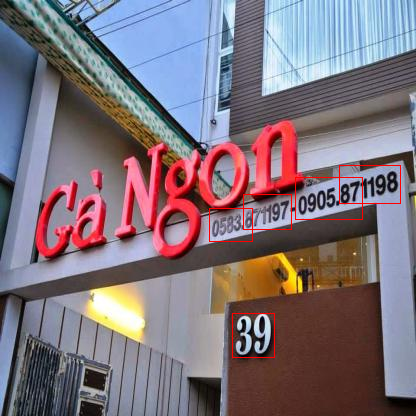



im1645_jpg.rf.abb4a266985cecdbb4a88a347abdb05d.txt
XINI
OND
MUT
LONG
EEO
ĐẾN
TRANST
QUY
CAM
KHÁCH
KHÂU


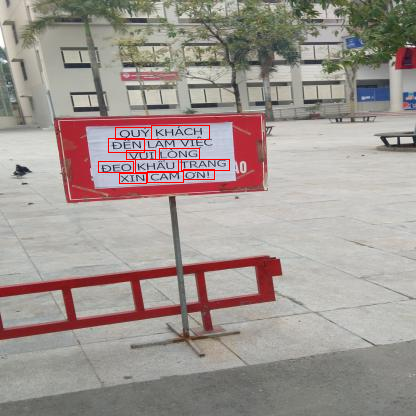



im0471_jpg.rf.628b29f0bde94730dcbd2f746f8be3b1.txt
VỪA ĐEI
Replonk
1
TỬ TỬ
Tế
TÔI
TÔI
VỪA
SẾP
YÊU
DEP
CỦA
TỪA
CÔNG
VIỆC
MÌNH
TRAI


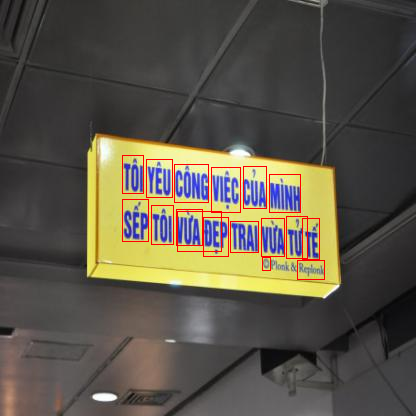



im0900_jpg.rf.a7f94b699bc33bbab4c0cf3a7a77e0d9.txt
03
CHÙA
CỬA
CỔNG


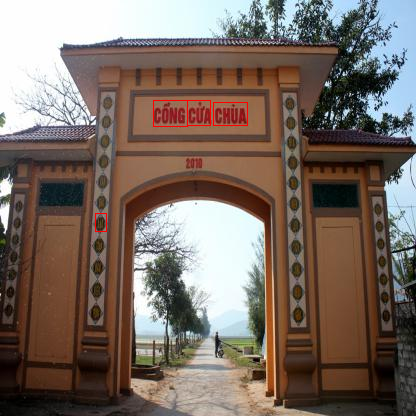



im0459_jpg.rf.0ee29d3c66ceeadc8242397dd4f96b83.txt
(08)
116
Fax
vi
DT
142
3
39
NGHIỆP
165
142
edu
WWA
cbum
RƯỜNG
MẠI
VÀ
NAM
PHÒNG
Website
CBAM
CÔNG
VIỆT
DOANH
Lý
NGHIỆP
THƯƠNG 1
ĐÀO
QUẢN
TẠO


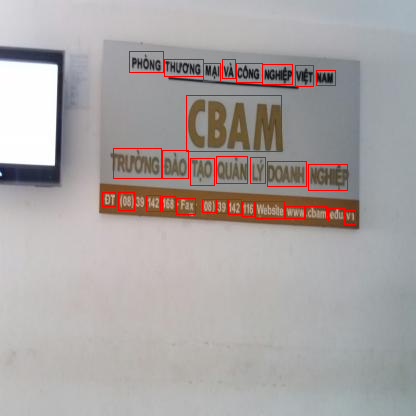



im0501_jpg.rf.e167c7b27a2b73598379e5a34568e00e.txt
ĐỘ
TỐC
DOAN
CSGT
DO
THƯỜNG
DƯƠNG


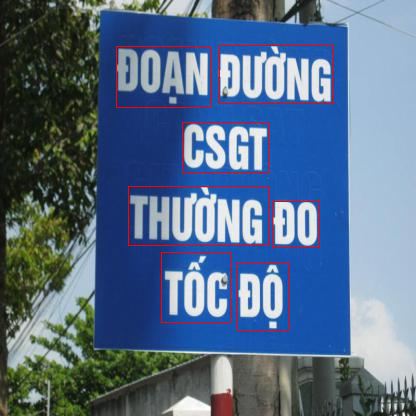



im1694_jpg.rf.544fd941f8f67a8b02075a262fcd6bae.txt
HỒ TRỌ
01287
0939
60
TAIT
HÀNG T
Lãnh
NGĂN
69
TRỢ
59
TIỀN
TUỔI:
GÓP
20
53
55
99
00
TRẢ
THỂ
VAY
CHẤP
KHÔNG
TIỀN
HỒ
NGÂN
HÀNG


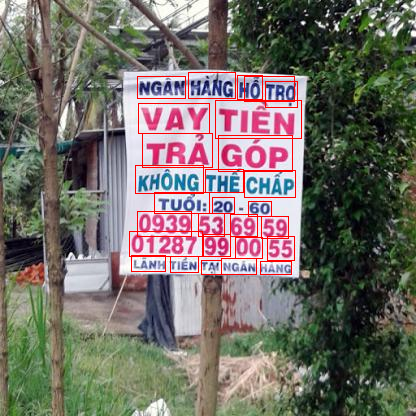



im0623_jpg.rf.f7f8fa5f370f4a4db94b8e0ce34702bc.txt
A
TER
II
CEND
TD
SOCIA
L
DIMMER
WHIN
EX
MINO
mas
11
LOINT
201
BII
m
Uvd
X
1
1
Mot
Gill
07:0702.213562
10
buroos
LORGS
WORK
11
HỘI
VID
Y
towy
ANIP
TRAM
TẾ
TRUNGS
CÔNG
Xã
CÔNG
TRUNG
HỘI
XÃ
AN
TÁC
TÁC
TÂM


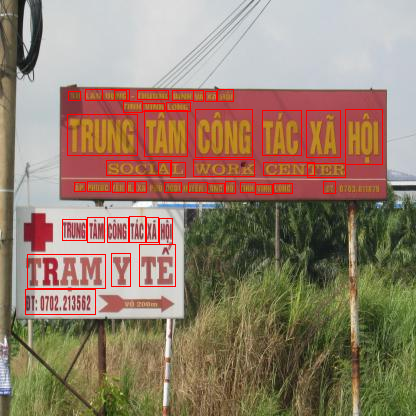



im0056_jpg.rf.6e738cb1460fc541ecbae5efb5a066ea.txt
MONE
Ush
lus
MABANKE
ward
NIMA
NAMA
ID
E
Unrel
TRƯƠNG
Uin
Hon
10
tặng
10009
Quat
TUNG
BÙNG
NAMA
08/01/2019
BANK
ĐAI
KHAIL
BÌNH


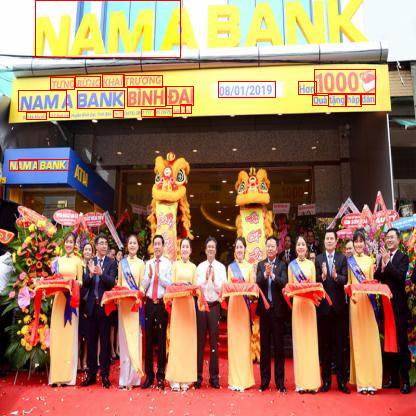



im1787_jpg.rf.088f54738ea69bc69133dd5cc3e5526d.txt
Bill
Thánh Canh
Cn
U
9
pepsi
Bánh
PHỤNG
Canh


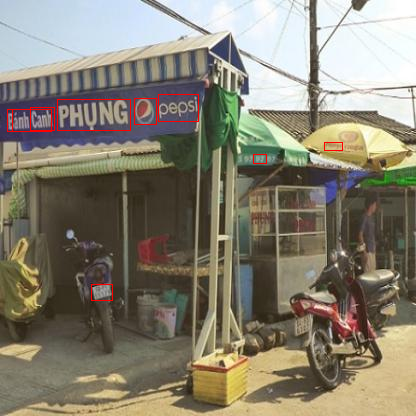



im0393_jpg.rf.26960dfd41bd153123cb8c679d8f4101.txt
NAM
PHUONG


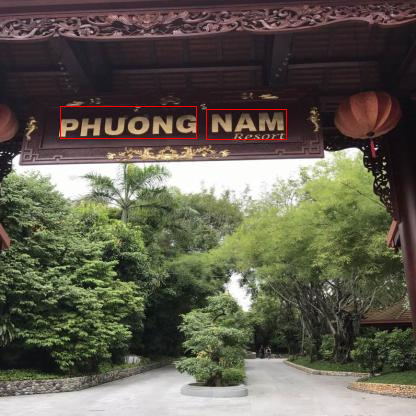



im1946_jpg.rf.55808b22848cd8bf4d165b77ab7ec921.txt
25
FC
Sao
Quai
Ma
Phải
Xoắng


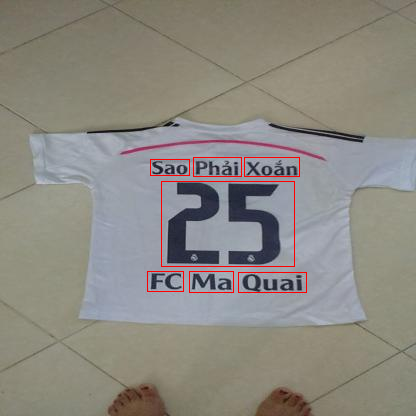



im0513_jpg.rf.0efe6e8a636d329a18ddd9e299f354cb.txt
BS
ĐOÀN
HÙNG
VĂN
PHÒNG
KHÁM


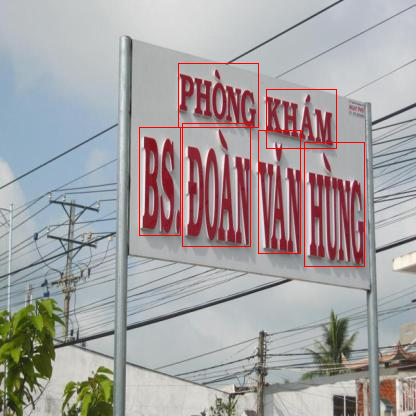



im0340_jpg.rf.d2f9d9da0db30a803807d779cb0a01f6.txt
LANTRAV
SANTAN
279
ISONATA
Tăng
lai
tới
toc
tương


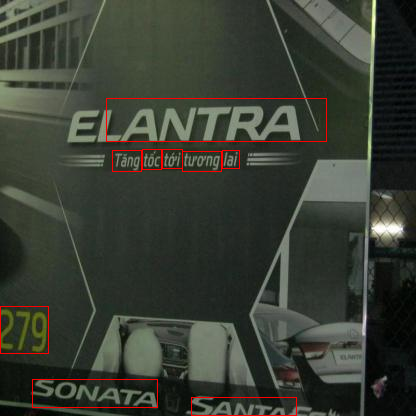



im0652_jpg.rf.130ec141eac81d4494a4b34987f7842e.txt
HUGH
DCT
VỀN
ETPS
RB
10
NGUI
HOC
QUANGE
Ani
1
TRUNG
HUE
HUE
zuto
HOCS
2015
MOT
STRUGNG
Fied
NAM
HUG
NAME
MUNGS
CHAO


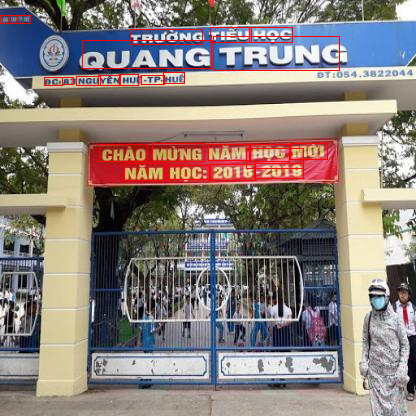



im0175_jpg.rf.26b8dd05b95fb0549ee9100a88519fcf.txt
w
TR
K
65
T
BYONO
HẦ
347
NỘI
196
ĐẠI
PHAMS


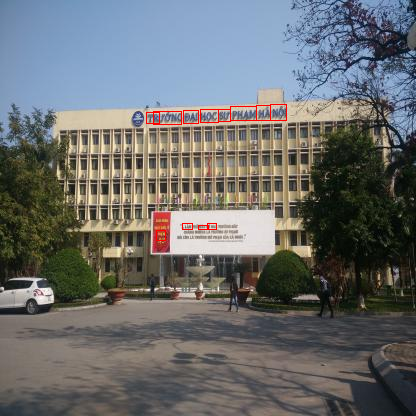



im1458_jpg.rf.dde1c1a08a82d1233974494af2d5631f.txt
STINE
mobility
butt


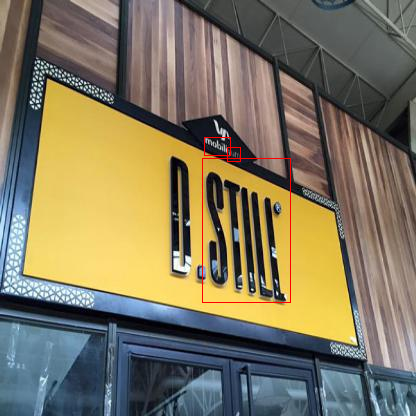



im0725_jpg.rf.189668335b76bbee24cf81a5985aa4f5.txt
1
2020
LỄ
VAU
nyo
HỌC
MINHI
puộc
2019
KHAI
NĂM
CHÍ
HỒ
PHỐI
GIẢNG
THANH


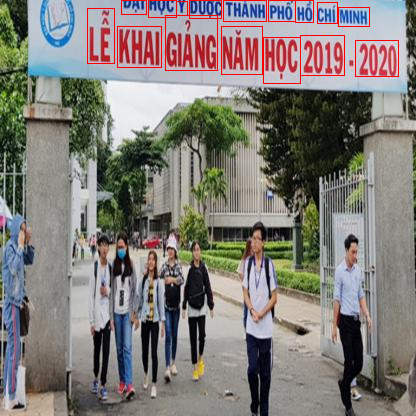



im0388_jpg.rf.09aa22760c4d8cff2c2176fccdcfe1c4.txt
CẦU DIỄN
11
19
INVARICIAL
%
Rập
DIỀN
05
5
TW
%
hàng
1
ELININO
NA
GIANG


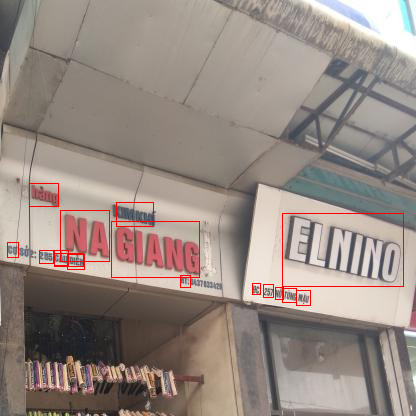



im0901_jpg.rf.60c7fa627b32777706f39b5392c17454.txt
08
13139969383
24k
1812-24
DNTN)
Tell
PE
09866027
ĐÁM
2
ANH
BÁO
Trung
LƯỢNG
CHAT
TH
huyên
VANCE
UY
Quang
vụ
TIN
Mobile
Gia
TUẤN
Trao
THƯƠNG
DỊCH
BAC
Mua
Bán
Đổi
Công l
MAI
Vang


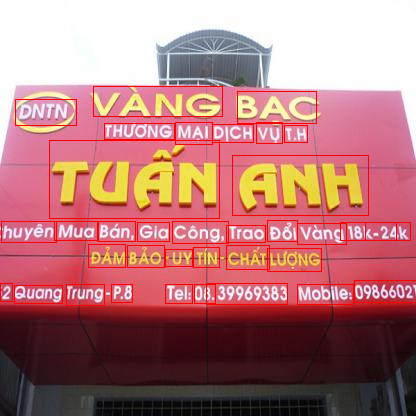



im0928_jpg.rf.4d749d524ffddc15208a2337c5e29231.txt
1
Unwell
N2
LAI
IMA
AN
HANK
JOAN
NHÀ
PHÚC
CHO
THÔNG 1
GIAO
MOIL


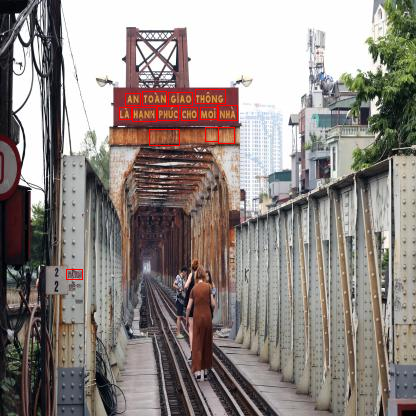



im1326_jpg.rf.a81e26381b28bb015cc80b6f5c2e2df8.txt
NI
16
UT
mill
mr
11101701
TRA
co
1
01
Ed
IUING
965
011
30
lóc
IN
DIAN
1
Jinh
IH
Mky
10
HOA
E
DING
QUỐC
Dep
6


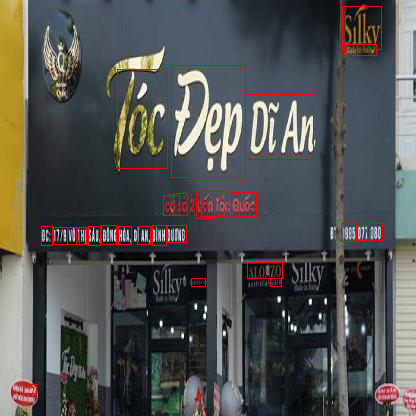



im0132_jpg.rf.6ef2b4f82ea40da694421166c9747245.txt
HA
P
ĐI
LONG
Vào
cáu
co
NHU
KHÔNG


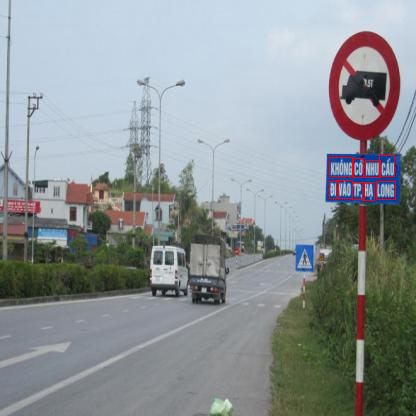



im0962_jpg.rf.062e60aa0279b34869af8c856b491b70.txt
1
mu
ỀN ĐÓ
01
XE VI
191
0
XE
IE
u
PHẢI
PW
DISE
EDẠP
X
MÔ T
TO, XE
LING
Thông
XE
ĐỀN
MÁY
ĐƯỢC
PHÉP
10
PHO
ĐỘNG


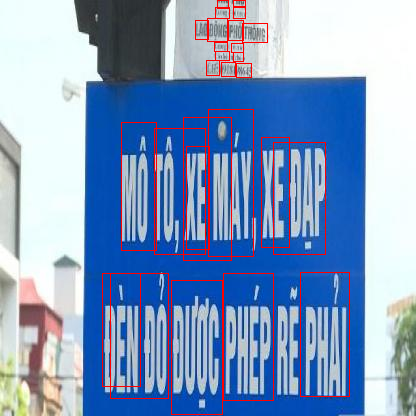



im0421_jpg.rf.749d41da0bf8c933f1769363cde0bbb3.txt
IBLA
51
HỌC
DAI
LAP
TRƯỜNG
ĐÀ


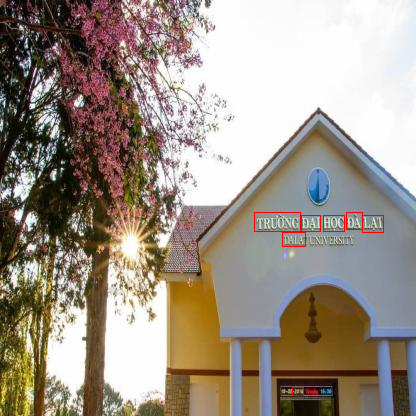



im0611_jpg.rf.bfc23c151adc4591270ca7fcf977fac0.txt
JOANO
2
ĐC
19555
1
F
56
201
Hosses
KG
MTC
INING
H
DY
HANH
Loke
XI
VINH
10
THANKS
Ckc
101
SẮT
MĂNG
Bms
ĐÁ
TRI
TRANG
NỘI
THẤT
XÂY
CÁT
LONG
VẬT
LIỆU
CỬA
HÀNG
DỰNG


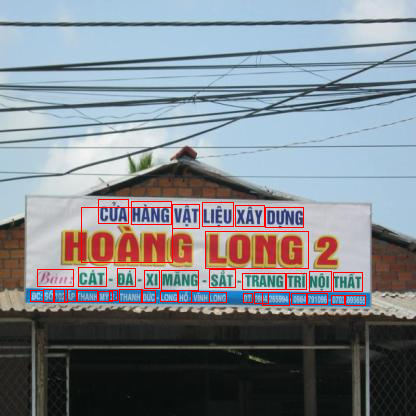



im1166_jpg.rf.e78943f9a70f2696d34f2dabeebc91df.txt
3618310
QUAN
DCS
CHAN
Hue
03
VEGETARIAN
Kiệt
Lệ
đặt:
Nhật
10
HỘI
THE
THIÊN
Nhận
TIỆC
TÂM
NHẬT
NGHI,
HOAN
SINH
CƯỚI,
LIÊN


KeyboardInterrupt: ignored

In [ ]:
import glob
from PIL import Image
import cv2
from google.colab.patches import cv2_imshow
pathLabel='yolov5/runs/detect/exp3/labels/'
pathImg='VietnameseSign-1/test/images/'
imgSize=416
for labels in glob.glob(pathLabel+'*.txt'):
    print(labels[len(pathLabel):])
    imgName=labels[len(pathLabel):len(labels)-4]
    img=cv2.imread(pathImg+imgName+'.jpg')
    with open(labels, 'r') as file:
      loc = file.readlines()
    for predD in loc:
      predD=list(map(float,predD.split()))
      left=int((predD[1]-predD[3]/2)*imgSize)
      top=int((predD[2]-predD[4]/2)*imgSize)
      right=int((predD[1]+predD[3]/2)*imgSize)
      bottom=int((predD[2]+predD[4]/2)*imgSize)
      cv2.rectangle(img,(left,top),(right,bottom),(0,0,255))
      cImg=Image.fromarray(img[top:bottom,left:right])
      textPredict=detector.predict(cImg)
      print(textPredict)
      # img=cv2_img_add_text(img, textPredict, (left,top), text_size=(top-bottom)//2)

    cv2_imshow(img)
    break
    print("\n")

In [ ]:
from VietnameseSign.tools import utils
trainedWeight= utils.download_weights('https://drive.google.com/uc?id=1Q_G6Lmf_7bT6q7c8mK8ZeDvn4aRY5jrD')

Cached Downloading: /root/.cache/gdown/https-COLON--SLASH--SLASH-drive.google.com-SLASH-uc-QUESTION-id-EQUAL-1Q_G6Lmf_7bT6q7c8mK8ZeDvn4aRY5jrD
Downloading...
From: https://drive.google.com/uc?id=1Q_G6Lmf_7bT6q7c8mK8ZeDvn4aRY5jrD
To: /root/.cache/gdown/tmpme4d94dc/dl
100%|██████████| 14.8M/14.8M [00:00<00:00, 34.0MB/s]


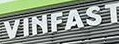

In [ ]:
import glob
from IPython.display import Image, display
for imageName in glob.glob('yolov5/runs/detect/exp3/*.jpg'):
    display(Image(filename=imageName, width=900))
    print("\n")

In [ ]:
import cv2
import torch
import sys
sys.path.append('yolov5')
from PIL import Image
from yolov5.utils import dataloaders
from yolov5.models.common import AutoShape as Model
from yolov5 import detect
   # for PIL/cv2/np inputs and NMS
model= torch.load('/content/best.pt',map_location=torch.device('cuda:0'))
# model=model['model']

In [ ]:
imgs=cv2.imread('input2.jpg')
img=torch.from_numpy(imgs)
result=model(imgs)
# abc=detect.run('/content/best.pt','/content/input2.jpg')
# # results = model(img)  # includes NMS
# print(type(abc))
# # Results
# results.print()  # print results to screen
# results.show()  # display results
# results.save()  # save as results1.jpg, results2.jpg... etc.

# # Data
# print('\n', results.xyxy[0])  

In [ ]:
torch.save(model['model'].state_dict(), '/content/w.pth')

In [ ]:

model2 = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=False)
model2.load_state_dict(torch.load('/content/w.pth'))

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 v6.1-191-gd29df68 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla K80, 11441MiB)


                 from  n    params  module                                  arguments                     
  0                -1  1      3520  models.common.Conv                      [3, 32, 6, 2, 2]              
  1                -1  1     18560  models.common.Conv                      [32, 64, 3, 2]                
  2                -1  1     18816  models.common.C3                        [64, 64, 1]                   
  3                -1  1     73984  models.common.Conv                      [64, 128, 3, 2]               
  4                -1  2    115712  models.common.C3                        [128, 128, 2]                 
  5                -1  1    295424  models.common.Conv                      [128, 256, 3, 2]              
  6                -1  3    625152  models.common.C3                        [256, 256, 3] 

RuntimeError: ignored

In [ ]:
import cv2
import torch
from PIL import Image

# Model
model = torch.hub.load('ultralytics/yolov5', 'yolov5s')

# Images
for f in 'zidane.jpg', 'bus.jpg':
    torch.hub.download_url_to_file('https://ultralytics.com/images/' + f, f)  # download 2 images
im1 = Image.open('zidane.jpg')  # PIL image
im2 = cv2.imread('bus.jpg')[..., ::-1]  # OpenCV image (BGR to RGB)
imgs = [im1, im2]  # batch of images

# Inference
results = model(imgs, size=640)  # includes NMS
print(type(results))

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 v6.1-191-gd29df68 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla K80, 11441MiB)

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients
Adding AutoShape... 


  0%|          | 0.00/165k [00:00<?, ?B/s]

  0%|          | 0.00/476k [00:00<?, ?B/s]

<class 'models.common.Detections'>
